In [2]:
import sys
sys.path.append('/Users/laurenfrank/Mittal/cheme546')

In [3]:
# import necessary functions
from tilseg.preprocessing import preprocess

In [5]:
# preprocess the data to save images, and output a superpatch
# as a numpy array, stored in the variable `superpatch`
superpatch = preprocess('/Users/example_user/slides_folder/')

ValueError: System cannot find the specified path to slide.                          Please ensure os.stat() can run on your path.

## Model Selection  
This section implements functions from the **model_selection** module of the tilseg package. Once the superpatch is extracted, the different hyperparameters can be evaluated to identify those which best cluster the data according to various different methods, including:  
- Silhouette Score
- Calinski-Harabasz score
- Davies-Bouldin score
- Elbow method (for KMeans only)  

There are also functions which allow use of any metric from sklearn, as long as it inherits from the sklearn.ClusterMixin class.  
*Note:* This module can either be implemented as a python module as shown here, or can be run from the command line using the opt_cluster_hyperparameters.py script. This script can be called as long as the depencies found in the install section of the README.md are installed (or from inside the conda environment), by running the command `python opt_cluster_hyperparameters.py <args>`

#### Reshape Superpatch and Sample
Model selection will start by reshaping the superpatch numpy array to be a 3xL array, where L is the width\*height of the original superpatch. The columns will thus represent RGB values, and each row will represent an individual pixel 

In [ ]:
# Import neccesary libraries
import numpy as np
import tilseg.model_selection

In [ ]:
# Reshape the superpatch so it is consistant with the input needed by model selection
# also divide by 255. to scale the pixel values to be between 0 and 1
patch_array = superpatch.reshape((-1,3))/255.
# DBSCAN, OPTICS, and BIRCH all have much higher space complexities than KMeans, and so actually can't be run 
# on the full superpatch currently. The model_selection module has a method for taking a sample from the superpatch, 
# and that will be used here so that all the algorithms can at least be optimized to a sample of the superpatch
patch_array_sample = tilseg.model_selection.sample_patch(patch_array, 5_000)

#### Optimize Hyperparameters
After the numpy array is obtained, the hyperparameters of the clustering algorithms can now be optimized. For the opt_\<cluster algorithm\> wrapper functions, lists of hyperparameters to try must be provided. These can be created manually, or the generate_hyperparameter_combinations helper function can be used to generate combinations of hyperparameters. 

tilseg.model_selection.<span style="color:red">opt_{clustering-algorithm}</span>(<i>data: np.array, {hyperparameter-lists}, metric: str="silhouette", verbose: bool =False, **kwargs</i>):

    Function to optimize the hyperparameters for clustering-algorithm
    Parameters
    ----------
    data: np.array
        The array containing the RGB values for the pixels in the patch or superpatch
    {hyperparameter-lists}: list
        Lists of hyperparameters to try
    verbose: bool
        Whether a verbose output is desired, if True will print hyperparameters currently being tried, and a list of               clusters that this generates
    **kwargs: 
        Keyword args which are passed to metric class
    Returns
    -------
    hyperparameters: dict
        Dictionary of optimized hyperparameters

In [ ]:
%%capture
# Example of generate_hyperparameter_combinations function
# (These have been chosen so that following the hyperparameter optimization,
#     there are between 2 and 4 clusters for the later analyses)
dbscan_hyperparameter_dict = {"eps":[0.001, 0.01, 0.03578947, 0.5, 0.6,0.7,0.9],
                              "min_samples":[5, 500, 5000]}
optics_hyperparameters_dict = {"min_samples":[1,5,15,25,45,60],
                               "max_eps":[np.inf,1,3]}
kmeans_hyperparameters_dict = {"n_clusters":[1,2,3,4,5,6,7,8,9,10]}
birch_hyperparameters_dict = {"threshold":[0.1,0.5,1,5],
                              "branching_factor":[10,25,50],
                              "n_clusters":[2,3]}
# Now the generate_hyperparameter_combinations can be used to generate all the combinations of these hyperparameter
#    levels
dbscan_hyper_combs = tilseg.model_selection.generate_hyperparameter_combinations(dbscan_hyperparameter_dict)
optics_hyper_combs = tilseg.model_selection.generate_hyperparameter_combinations(optics_hyperparameters_dict)
kmeans_hyper_combs = tilseg.model_selection.generate_hyperparameter_combinations(kmeans_hyperparameters_dict)
birch_hyper_combs = tilseg.model_selection.generate_hyperparameter_combinations(birch_hyperparameters_dict)
# Following the creation of these hyperparameter dictionaries, they can be used to optimize the hyperparameters
opt_dbscan_hyper = tilseg.model_selection.opt_dbscan(patch_array_sample,
                                                     eps=dbscan_hyper_combs["eps"],
                                                     min_samples=dbscan_hyper_combs["min_samples"],
                                                     metric="Calinski Harabasz")
opt_optics_hyper = tilseg.model_selection.opt_optics(patch_array_sample,
                                                     min_samples=optics_hyper_combs["min_samples"],
                                                     max_eps=optics_hyper_combs["max_eps"],
                                                     metric="Calinski Harabasz")
# Since kmeans can handle the full superpatch, that will be used here
opt_kmeans_hyper = tilseg.model_selection.opt_kmeans(patch_array,
                                                     n_clusters=kmeans_hyper_combs["n_clusters"])
opt_birch_hyper = tilseg.model_selection.opt_birch(patch_array,
                                                   threshold=birch_hyper_combs["threshold"],
                                                   branching_factor=birch_hyper_combs["branching_factor"],
                                                   n_clusters=birch_hyper_combs["n_clusters"],
                                                   metric="Calinski Harabasz")

Now the optimized hyperparameters can be used for segmentation.

## Segmentation

The next part of this notebook implements functions in the <b>seg</b> module of the tilseg package. This is best done after extracting patches from whole slide images using the <i>preprocessing</i> module and hyperparameter optimization using the <i>model_selection</i> module. This module facilitates clustering pixels based on RGB values using KMeans, DBSCAN, OPTICS, or BIRCH algorithms and then segmenting and enumerating TILs from the patches.


There are three main functions that users can call in this module that perform different tasks in the pipeline of segmenting and enumerating TILs from a patch:
1. <b>KMeans_superpatch_fit</b>
2. <b>clustering_score</b>
3. <b>segment_TILs</b>

In [1]:
# importing the seg module from tilseg
import tilseg.seg as seg
# allows us to compute the processing time
import time
import numpy as np

Make edits to these filepaths to match your local paths:

In [2]:
# Directory containing the patches that are going to have TILs segmented
in_dir_path='/Users/abishek/Desktop/DataScienceClasses/Project/patches'

# Directory where output files from tilseg.seg.segment_TILs will be saved
# In this notebook, output files following fitting a clustering model on the same patch to have TILs segmented
# will be saved here
out_dir_path='/Users/abishek/Desktop/DataScienceClasses/Project/img_postprocessing/patch'

# Directory where output files from tilseg.seg.segment_TILs will be saved
# In this notebook, output files that were clustered using a model fitted on a superpatch will be saved here
out_dir_path_super='/Users/abishek/Desktop/DataScienceClasses/Project/img_postprocessing/super_patch'

# Path to a patch that will be scored on using tilseg.seg.clustering_score
patch_path='/Users/abishek/Desktop/DataScienceClasses/Project/patches/TCGA-3C-AALI-01Z-00-DX1_T370.tif'

# Path to a superpatch that will have a model fitted to it using tilseg.seg.KMeans_superpatch_fit
superpatch_path='/Users/abishek/Desktop/DataScienceClasses/Project/super_patch/super_patch.tif'

# Path to a small sample of the pixels in a patch that can be used to calculate Silhouette scores and run DBSCAN,
# OPTICS, and BIRCH clustering algorithms which are otherwise very computationally expensive
sample_patch_path='/Users/abishek/Desktop/DataScienceClasses/TILseg/tilseg/test/test_patches/patches/test_small_patch.tif'

Optimized hyperparameters from <i>tilseg.seg.model_selection</i> to be used in <b>tilseg.seg.clustering_score</b> and <b>tilseg.seg.segment_TILs</b>:

In [3]:
KMeans_hyperopt = {'n_clusters': 4}
DBSCAN_hyperopt = {'eps': 0.03578947, 'min_samples': 5}
OPTICS_hyperopt = {"min_samples": 45, "max_eps": np.inf}
BIRCH_hyperopt = {"threshold": 0.1, "branching_factor": 10, "n_clusters": 3}

<b><font size="+1">tilseg.seg.KMeans_superpatch_fit:</b></font>

tilseg.seg.<span style="color:red">KMeans_superpatch_fit</span>(<i>patch_path: str, hyperparameter_dict: dict = {'n_clusters: 4'}</i>)
    
    Fits a KMeans clustering model to a patch that will be used to cluster other patches
    KMeans is the only clustering algorithms that allows fitting a model to one patch clustering on another
    All other clustering algorithms need to be fitted on the same patch that needs to be clustered
    It makes sense to use this function to fit a KMeans clustering model to a superpatch that can capture 
    H&E  stain variation across patients and technologies

    Parameters
    -----
    patch_path: str
        the directory path to the patch that the model will be fitted to
        obtain cluster decision boundaries
    hyperparameter_dict: dict
        dicitonary of hyperparameters for KMeans containing 'n_clusters' as
        the only key
        this dictionary can be obtained by reading the JSON file outputted by
        tilseg.module_selection

    Returns
    -----
    model: sklearn.base.ClusterMixin
        the fitted model

This is an example of a sample super patch that attempts to capture the stain variation across patients and technology types so that the model can accurately predict on multiple different variations of H&E staining:

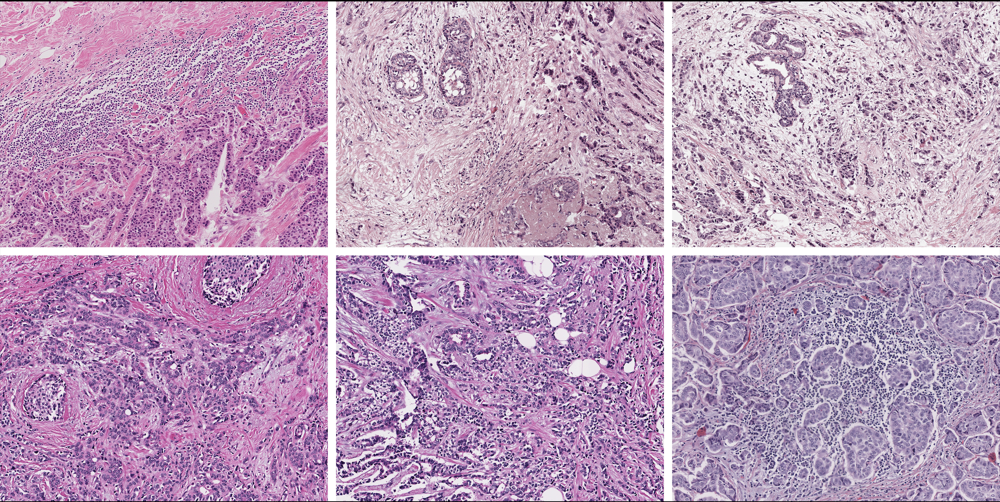

In [4]:
initial_time = time.time()

model_super = seg.KMeans_superpatch_fit(
    patch_path=superpatch_path,
    hyperparameter_dict={'n_clusters': 4})

final_time = time.time()
print(f'Time to train this model is {round(final_time-initial_time)} seconds')

Time to train this model is 64 seconds


In [5]:
print(f'The model is trained on the super patch: {model_super}')

The model is trained on the super patch: KMeans(max_iter=20, n_clusters=4, n_init=3, tol=0.001)


<b><font size="+1">tilseg.seg.clustering_score:</b></font>

tilseg.seg.<span style="color:red">clustering_score</span>(<i>patch_path: str, hyperparameter_dict: dict = None, algorithm: str = 'KMeans', model: sklearn.cluster._kmeans.KMeans = None, gen_s_score: bool = False, gen_ch_score: bool = True, gen_db_score: bool = True</i>)
    
    Scores clustering models that have been fitted and predicted on a patch
    The motive of this function is to test out clustering algorithms on a single patch
    The goal of this function is NOT to get high throughput scores from multiple patches in a whole slide image

    Parameters
    -----
    patch_path: str
        the directory path to the patch that will be fitted and/or clustered
        on to produce cluster labels that will be used for the scoring
    hyperparameter_dict: dict
        dicitonary of hyperparameters for the chosen algorithm
        this dictionary can be read by the JSON file outputted by
        tilseg.model_selection module
        for KMeans: dictionary should have 'n_clusters' key
        for DBSCAN: dictionary should have 'eps' and 'min_samples' keys
        for OPTICS: dictionary should have 'min_samples' and 'max_eps' keys
        for BIRCH: dictionary should have 'threshold', 'branching_factor', and
        'n_clusters' keys
    algorithm: str
        the clustering algorithm to be used: 'KMeans', 'DBSCAN', 'OPTICS', or
        'BIRCH'
    model: sklearn.cluster._kmeans.KMeans
        sklearn KMeans model fitted on a superpatch
        Only enter an input for model if the chosen algorithm is KMeans and
        the goal is to score a model that has been fitted on a superpatch
        If no model is inputted, the clustering algorthim will fit a model on
        the patch found at patch_path
    gen_s_score: bool
        generate Silhouette score
    gen_ch_score: bool
        Calinski-Harabasz index
    gen_db_score: bool
        generate Davies-Bouldin score

    Returns
    -----
    s_score: float
        Silhouette score: ranges from -1 to 1 with 0 meaning indiffirent clusters, -1 meaning clustered assigned in a wrong fashion and
        1 meaning far apart and well separated clusters
    ch_score: float
        Calinski-Harabasz index: higher value of ch_score means the clusters
        are dense and well separated- there is no absolute cut-off value
    db_score: float
        Davies-Bouldin score: lower values mean better clustering with
        zero being the minimum value

It is very computationally expensive to calculate Silhouette scores, so gen_s_score has been turned to false below. That being said, the silhouette score generation does work and has been tested with unittests on a very small subsample of patch pixels.

Calculating Calinski_Harbasz index and Davies-Bouldin score on a sample patch using a KMeans model prefitted on the super patch:

In [8]:
initial_time = time.time()

s_score, ch_score, db_score= seg.clustering_score(patch_path=patch_path, 
                                              hyperparameter_dict=None,
                                              algorithm='KMeans',
                                              model=model_super, 
                                              gen_s_score=False,
                                              gen_ch_score=True,
                                              gen_db_score=True)

final_time = time.time()
print(s_score, ch_score, db_score)
print(f'Compute time for one patch is {round(final_time-initial_time)} seconds')

None 24594013.919508405 0.6592112805823329
Compute time for one patch is 3 seconds


Calculating Calinski_Harbasz index and Davies-Bouldin score by fitting a KMeans model on a sample patch and predicting on the same patch (not using a prefitted model):

In [9]:
initial_time = time.time()

s_score, ch_score, db_score= seg.clustering_score(patch_path=patch_path, 
                                              hyperparameter_dict={'n_clusters': 4},
                                              algorithm='KMeans',
                                              model=None, 
                                              gen_s_score=False,
                                              gen_ch_score=True,
                                              gen_db_score=True)

final_time = time.time()
print(s_score, ch_score, db_score)
print(f'Compute time for one patch is {round(final_time-initial_time)} seconds')

None 29721301.53894568 0.6795494740127035
Compute time for one patch is 11 seconds


The main advantage of using a superpatch to obtain cluster decision boundaries that can be used to predict the clusters on other patches is to mitigate the effects of stain variation. One big disadvantage is that the clustering may not be as "good" because it is not tailored to one specific type of staining. One can imagine that a possible problem would be reduced density and separation of clusters. This is illustrated with the calculated Calinski_Harbasz index values because the score without the superpatch is slightly larger than the score with the superpatch- but only marginally so. Additionally the Davies_Bouldin scores are also comparable relative to the best possible score of 1. Overall, for this particular patch and superpatch, fitting a model to the superpatch has negligible effects on the "goodness" of the clustering while also having a standardized model that can be applied to patches from other patients to produce reproducible labels.

This function can also be used to score clustering by DBSCAN, OPTICS, and BIRCH algorithms. These algorithms are have much larger time and space complexities than KMeans, and so are not implemented on a full patch in this notebook. To prove the concept that the metrics can be calculated for these algorithms, they are being implemented on a much smaller sample- only 0.01% of the pixels in the whole patch. Since the sample is small, Silhouette scores can now also be calculated relatively quickly. The results are shown below:

In [10]:
# KMeans on the sample
s, ch, db = seg.clustering_score(patch_path=sample_patch_path,
                     hyperparameter_dict=KMeans_hyperopt,
                     algorithm='KMeans',
                     model=None, 
                     gen_s_score=True,
                     gen_ch_score=True,
                     gen_db_score=True)
print(s, ch, db)

0.47579159962673573 2838.216393768331 0.6809719402390666


In [11]:
# DBSCAN on the sample
s, ch, db = seg.clustering_score(patch_path=sample_patch_path,
                     hyperparameter_dict=DBSCAN_hyperopt,
                     algorithm='DBSCAN',
                     model=None, 
                     gen_s_score=True,
                     gen_ch_score=True,
                     gen_db_score=True)
print(s, ch, db)

0.3868987612804688 193.2759103499563 1.1614910457421759


In [12]:
# OPTICS on the sample
s, ch, db = seg.clustering_score(patch_path=sample_patch_path,
                     hyperparameter_dict=OPTICS_hyperopt,
                     algorithm='OPTICS',
                     model=None, 
                     gen_s_score=True,
                     gen_ch_score=True,
                     gen_db_score=True)
print(s, ch, db)

0.00855533323482178 145.2616566322339 0.8541304922489418


In [13]:
# BIRCH on the sample
s, ch, db = seg.clustering_score(patch_path=sample_patch_path,
                     hyperparameter_dict=BIRCH_hyperopt,
                     algorithm='BIRCH',
                     model=None, 
                     gen_s_score=True,
                     gen_ch_score=True,
                     gen_db_score=True)
print(s, ch, db)

0.5282067761601962 1646.9130497194387 0.5538805394641905


<b><font size="+1">tilseg.seg.segment_TILs:</b></font>

tilseg.seg.<span style="color:red">segment_TILs</span>(<i>in_dir_path: str, out_dir_path: str = None, hyperparameter_dict: dict = None, algorithm: str = 'KMeans', model: sklearn.cluster._kmeans.KMeans = None, save_TILs_overlay: bool = False, save_cluster_masks: bool = False, save_cluster_overlays: bool = False, save_all_clusters_img: bool = False, save_csv: bool = False</i>)

    
    Applies a clustering model to patches and generates multiple files: TILs
    overlayed on the original H&E patch, binary segmentation masks of each
    cluster, individual clusters overlayed on the original patch, image of all
    the clusters, and a CSV file containing countour information of each TIL
    segmented from the patch
    Contour filters are applied to clustered objects to identify TILs

    Parameters
    -----
    in_dir_path: str
        the directory path to the patches that will clustered and have TILs
        segmented
        This directory could be one that contains all the extracted patches
        containing significant amount of tissue using the tilseg.preprocessing
        module
    out_dir: str
        the directory path where output images and CSV files will be saved
    hyperparameter_dict: dict
        dicitonary of hyperparameters for the chosen algorithm
        this dictionary can be read by the JSON file outputted by the
        tilseg.model_selection module
        for KMeans: dictionary should have 'n_clusters' key
        for DBSCAN: dictionary should have 'eps' and 'min_samples' keys
        for OPTICS: dictionary should have 'min_samples' and 'max_eps' keys
        for BIRCH: dictionary should have 'threshold', 'branching_factor', and
        'n_clusters' keys
    algorithm: str
        the clustering algorithm to be used: 'KMeans', 'DBSCAN', 'OPTICS', or
        'BIRCH'
    model: sklearn.cluster._kmeans.KMeans
        sklearn KMeans model fitted on a superpatch
        Only enter an input for model if the chosen algorithm is KMeans and the
        goal to cluster all the patches
        using a model fitted on a superpatch
        If no model is inputted, the clustering algorthim will fit a model on

    the same patch that it is clustering
    save_TILs_overlay: bool
        generate image containing TILs overlayed on the original H&E patch
    save_cluster_masks: bool
        generate image showing binary segmentation masks of each cluster
    save_cluster_overlays: bool
        generate image containing individual clusters overlayed on the original
        patch
    save_all_clusters_img: bool
        generate image of all the clusters
    save_csv: bool
        generate CSV file containing countour information of each TIL segmented
        from the patch

    Returns
    -----
    TIL_count_dict: dict
        contains patch filenames without the extension as the key and TIL
        counts in respective patches as the values

Segmenting TILs using a KMeans model prefitted on a super patch:

In [14]:
initial_time = time.time()

TIL_count_dict = seg.segment_TILs( 
                     in_dir_path=in_dir_path, 
                     out_dir_path=out_dir_path_super,
                     hyperparameter_dict=None,
                     model=model_super,
                     algorithm='KMeans',
                     save_TILs_overlay=True,
                     save_cluster_masks=True,
                     save_cluster_overlays=True,
                     save_all_clusters_img=True,
                     save_csv=True)

final_time = time.time()
print(f'Compute and image writing time for two patches in the directory is {round(final_time-initial_time)} seconds.')
print('Keys are the patch file names and the values are the counts of the TILs:')
print(TIL_count_dict)

Compute and image writing time for two patches in the directory is 68 seconds.
Keys are the patch file names and the values are the counts of the TILs:
{'TCGA-3C-AALI-01Z-00-DX1_T493': 1702, 'TCGA-3C-AALI-01Z-00-DX1_T370': 2961}


Segmenting TILs using a KMeans model fit and clustered/predicted on the same patch:

In [15]:
initial_time = time.time()

TIL_count_dict = seg.segment_TILs( 
                     in_dir_path=in_dir_path, 
                     out_dir_path=out_dir_path, 
                     hyperparameter_dict={'n_clusters': 4},
                     algorithm='KMeans',
                     model=None,
                     save_TILs_overlay=True,
                     save_cluster_masks=True,
                     save_cluster_overlays=True,
                     save_all_clusters_img=True,
                     save_csv=True)

final_time = time.time()
print(f'Compute and image writing time for two patches in the directory is {round(final_time-initial_time)} seconds.')
print('Keys are the patch file names and the values are the counts of the TILs:')
print(TIL_count_dict)

Compute and image writing time for two patches in the directory is 81 seconds.
Keys are the patch file names and the values are the counts of the TILs:
{'TCGA-3C-AALI-01Z-00-DX1_T493': 2706, 'TCGA-3C-AALI-01Z-00-DX1_T370': 4010}


tilseg.seg.segment_TILs has high functionality in the sense that the user can pick and choose what types of file outputs they need. If they set all the boolean inputs to False, then only TIL counts are output and an output directory path is not even required for the function to run since no files are being written. If all output file types are chosen, the output directory will have one directory for each patch in the input directory with the same file name as the patch image:
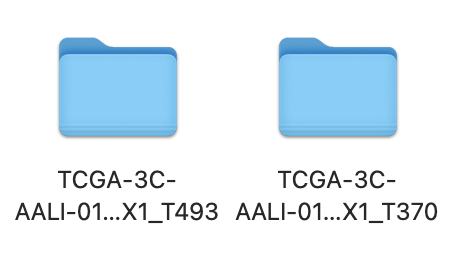

Each patch output directory will contain a bunch of files, descriptions of which can be found in the docstring for tilseg.seg.segment_TILs:
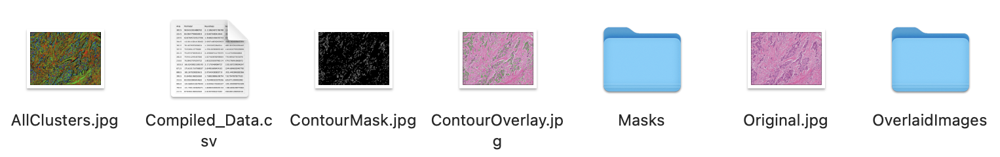

The Masks directory further contains binary masks for each cluster predicted:
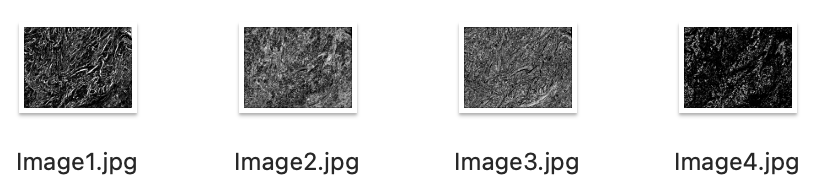

The OverlaidImages directory further contains clusters overlaid onto the original H&E patch:
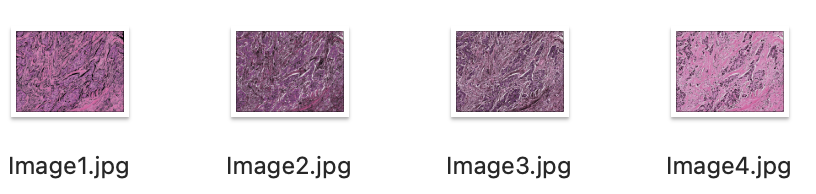

Comparing the clusters containing TILs for one of the segmented patches:


KMeans model fit on superpatch:
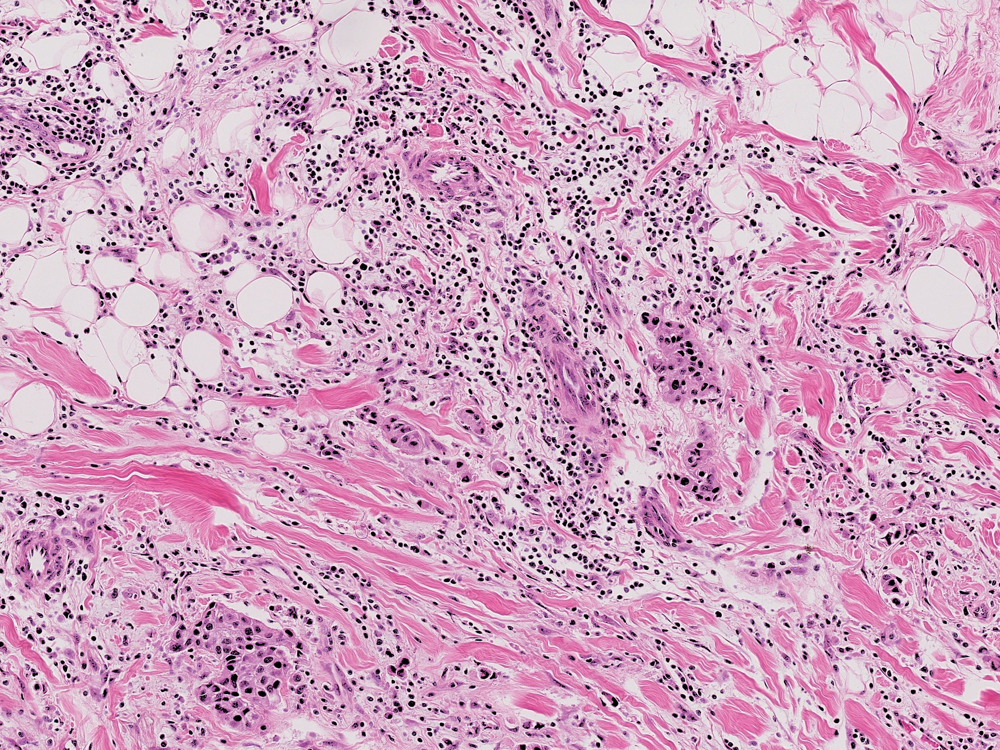


KMeans model fit and clustered on the same patch:
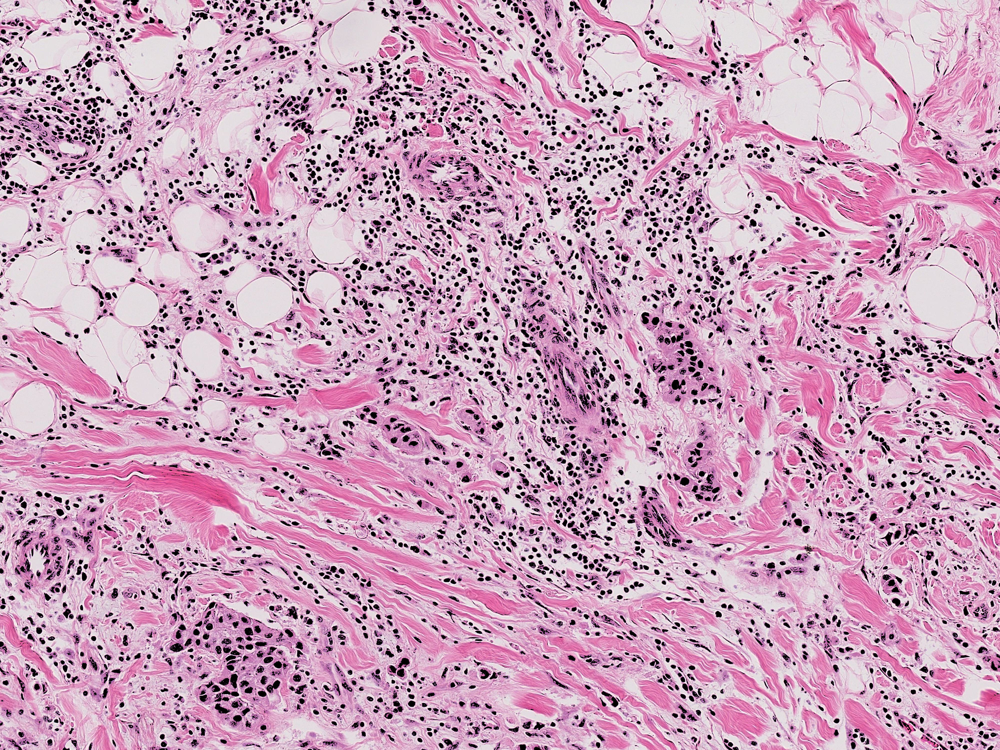

Comparing TILs maps for one the segmented patches:


KMeans model fit on superpatch:
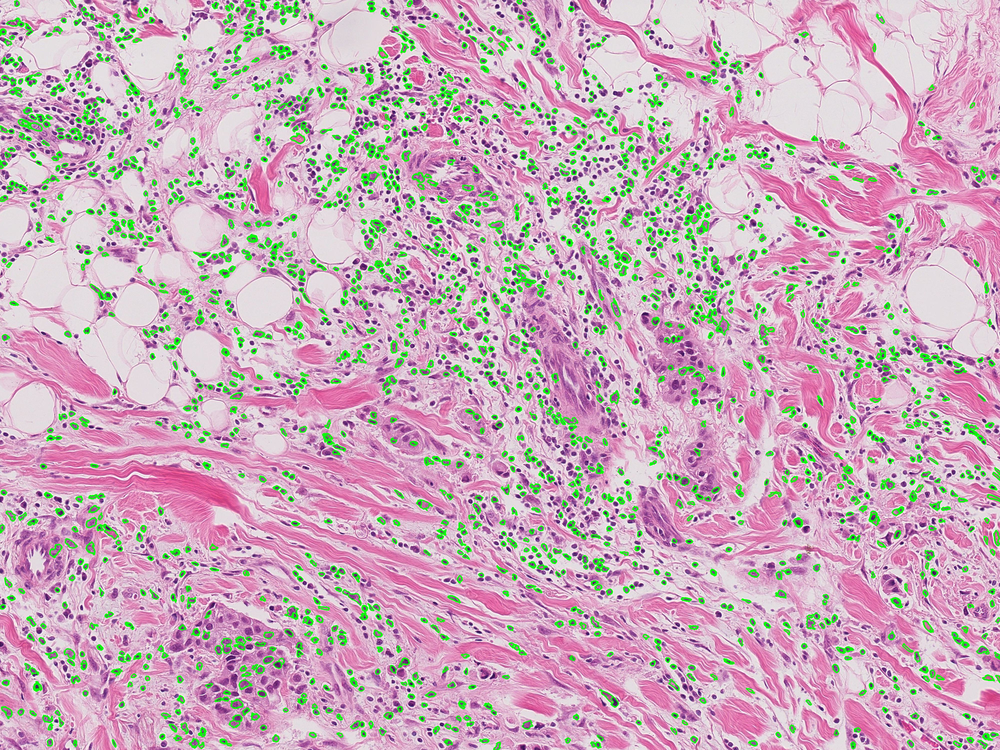

KMeans model fit and predicted on the same patch:
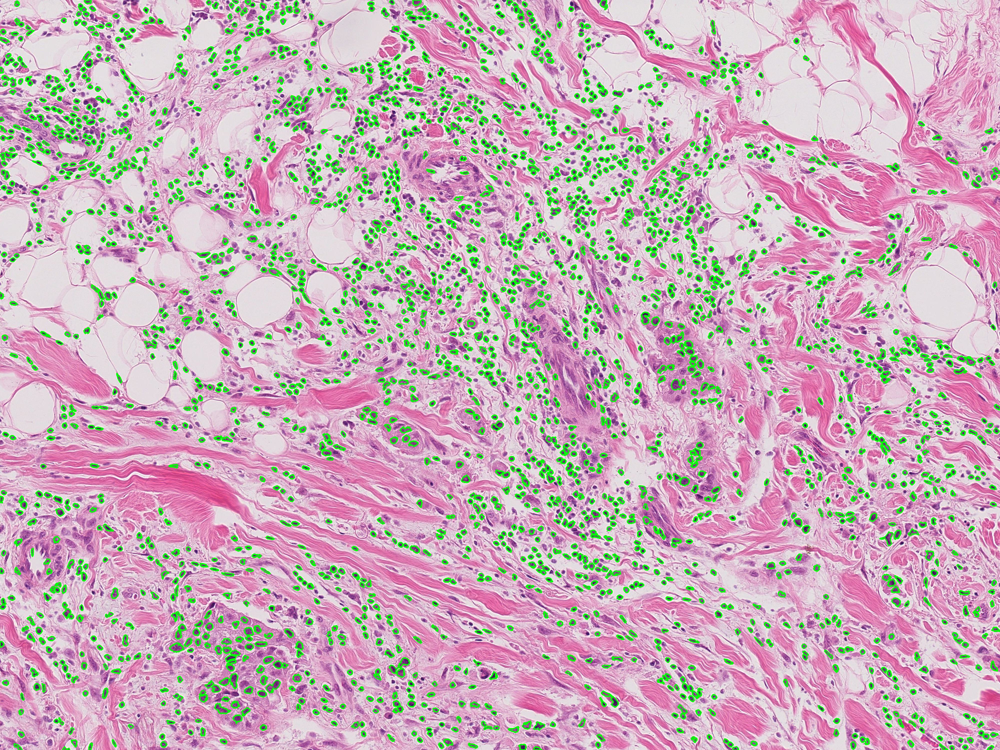

It can be seen from the clusters containing the TILs and the TILs maps themselves that fitting on a superpatch or the same patch produces comparable visual results. However, the difference in the TILs counts suggests room for optimizing contour filter parameters in tilseg.seg.segment_TILs function.